In [5]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
path = '/content/drive/MyDrive/horse'


In [7]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

def apply_augmentation(image, label=None):
    # Randomly choose an augmentation technique
    augmentation = np.random.choice(['rotate', 'flip', 'scale', 'brightness'])

    if augmentation == 'rotate':
        angle = np.random.uniform(-15, 15)
        image = rotate_image(image, angle)
    elif augmentation == 'flip':
        image = flip_image(image)
    elif augmentation == 'scale':
        scale_factor = np.random.uniform(0.8, 1.2)
        image = scale_image(image, scale_factor)
    elif augmentation == 'brightness':
        brightness_factor = np.random.uniform(0.5, 1.5)
        image = adjust_brightness(image, brightness_factor)

    # You can add more augmentations as needed

    # Display the augmented image (for visualization purposes)
    plt.imshow(image)
    plt.title(f'Augmentation: {augmentation}')
    plt.show()

    return image, label

def rotate_image(image, angle):
    rows, cols, _ = image.shape
    rotation_matrix = cv2.getRotationMatrix2D((cols / 2, rows / 2), angle, 1)
    rotated_image = cv2.warpAffine(image, rotation_matrix, (cols, rows))
    return rotated_image

def flip_image(image):
    return cv2.flip(image, 1)  # 1 for horizontal flip, 0 for vertical flip, -1 for both

def scale_image(image, scale_factor):
    rows, cols, _ = image.shape
    scaled_image = cv2.resize(image, (int(cols * scale_factor), int(rows * scale_factor)))
    return scaled_image

def adjust_brightness(image, brightness_factor):
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    hsv_image[:, :, 2] = np.clip(hsv_image[:, :, 2] * brightness_factor, 0, 255)
    brightened_image = cv2.cvtColor(hsv_image, cv2.COLOR_HSV2BGR)
    return brightened_image


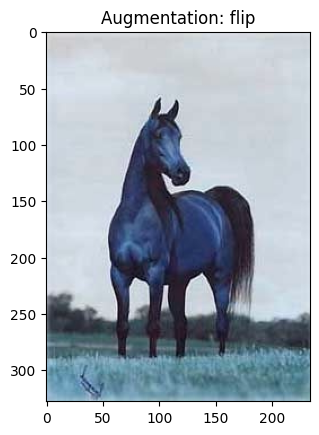

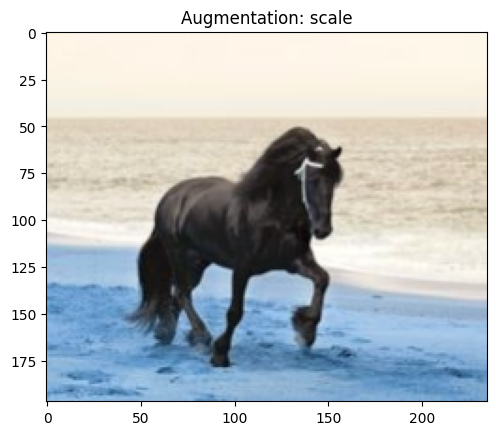

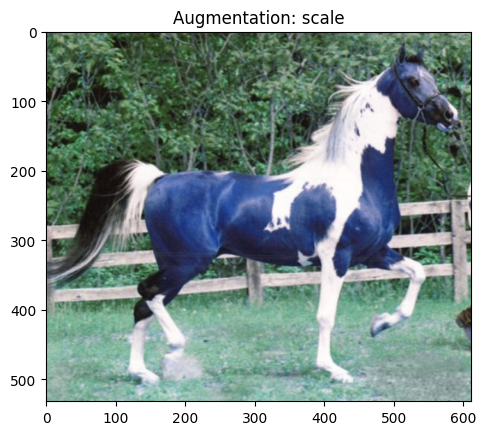

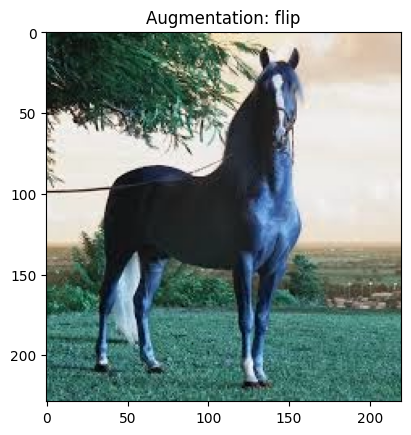

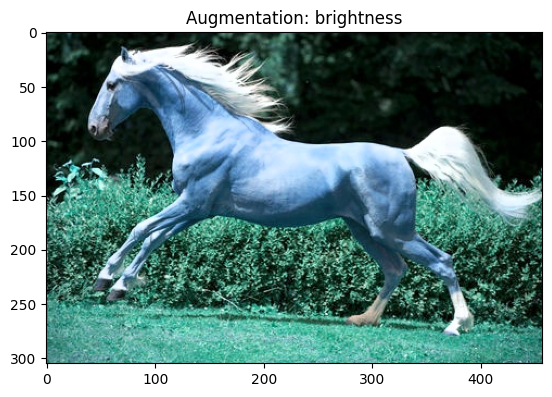

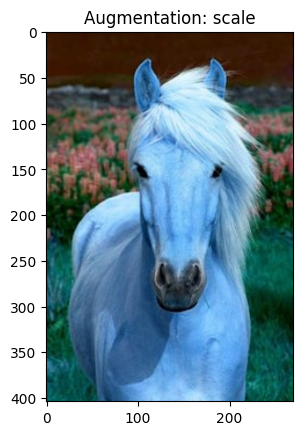

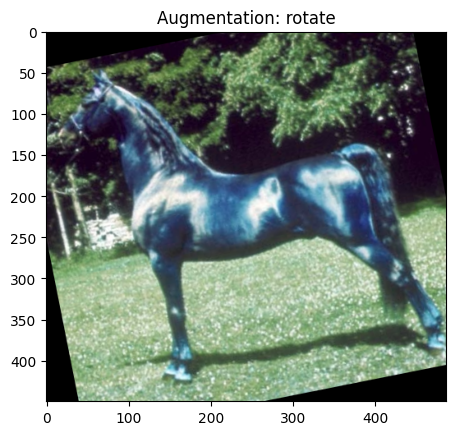

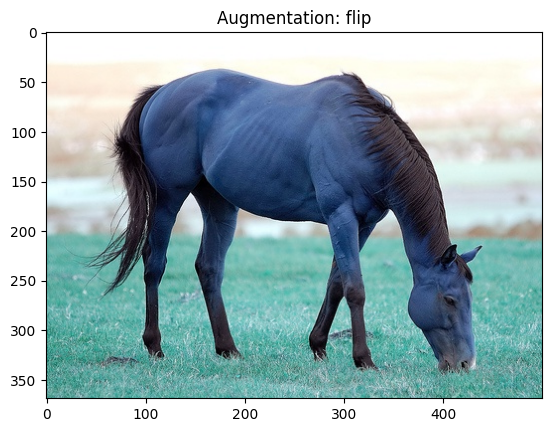

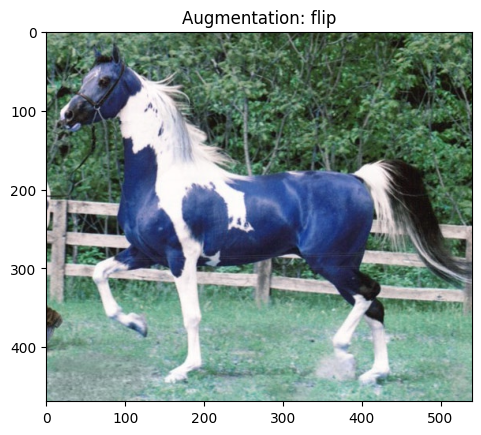

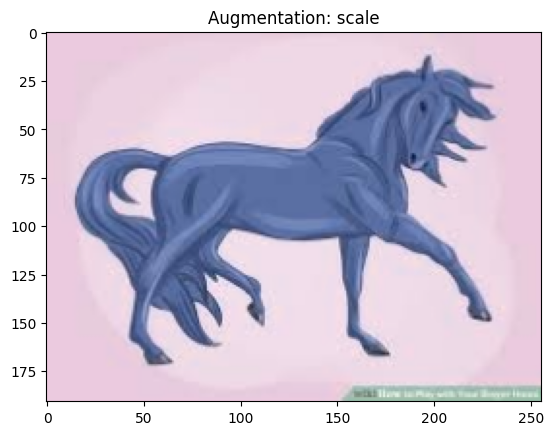

In [8]:
import os

# Function to apply augmentation to a folder of images
def augment_images_in_folder(folder_path):
    # Get the list of image file names in the folder
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    # Loop through each image file
    for image_file in image_files:
        # Construct the full path to the image
        image_path = os.path.join(folder_path, image_file)

        # Read the image
        image = cv2.imread(image_path)

        # Apply augmentation
        augmented_image, _ = apply_augmentation(image)

        # Save the augmented image (optional, if needed)
        augmented_image_path = os.path.join(folder_path, f"augmented_{image_file}")
        cv2.imwrite(augmented_image_path, augmented_image)

# Example usage:
folder_path ='/content/drive/MyDrive/horse'
augment_images_in_folder(folder_path)

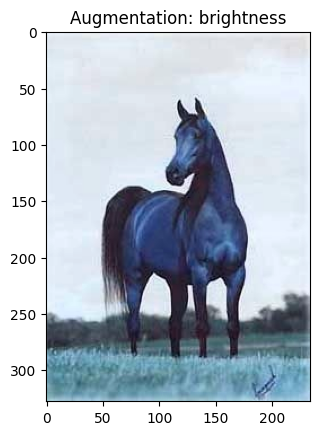

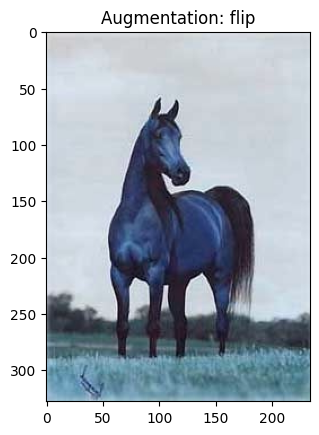

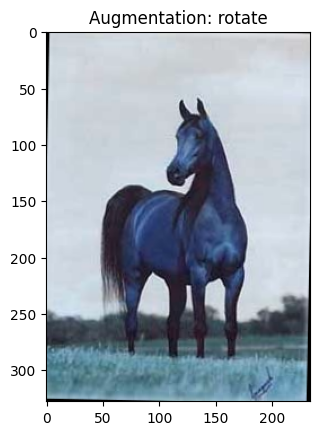

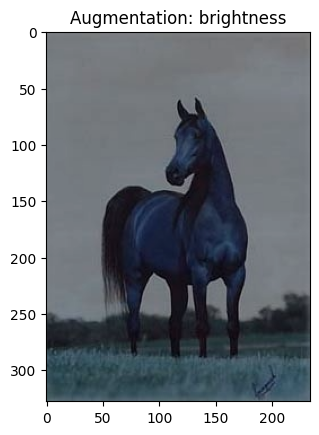

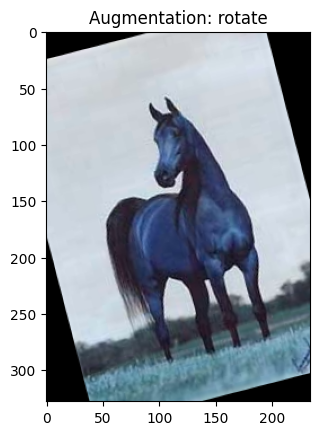

...

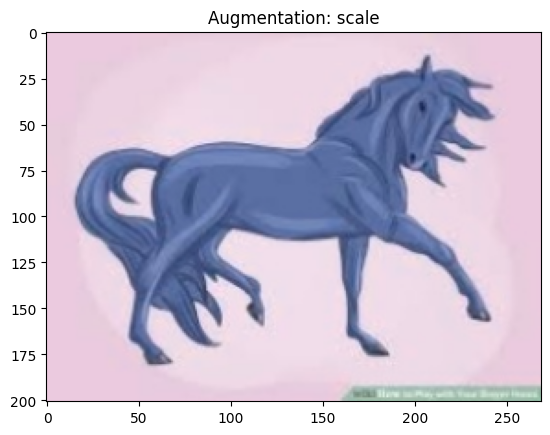

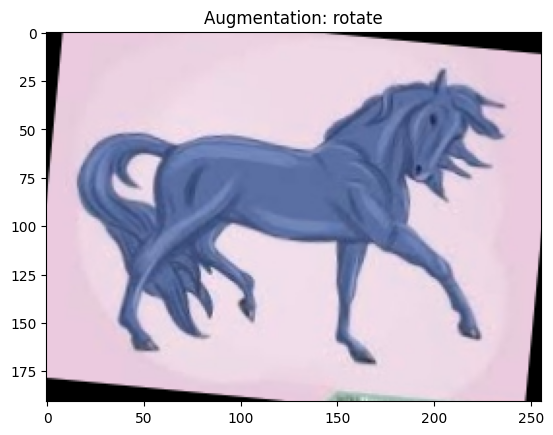

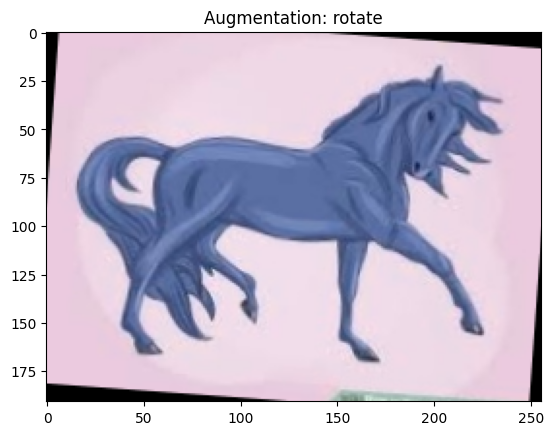

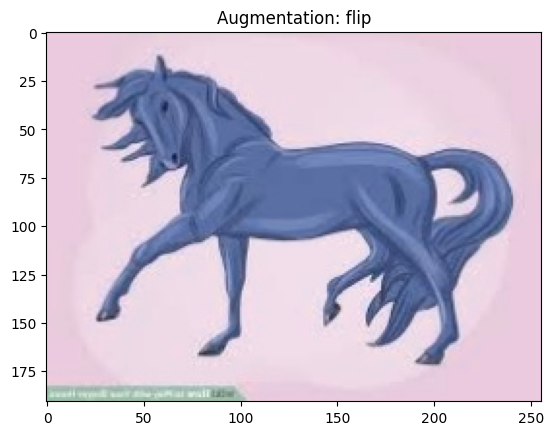

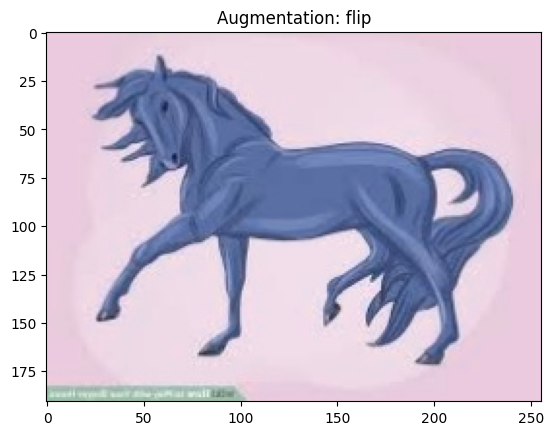

In [9]:
def augment_images_in_folder(folder_path, num_augmentations=5):
    # Get the list of image file names in the folder
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    # Loop through each image file
    for image_file in image_files:
        # Construct the full path to the image
        image_path = os.path.join(folder_path, image_file)

        # Read the image
        image = cv2.imread(image_path)

        # Apply augmentation and save multiple augmented images
        for i in range(num_augmentations):
            augmented_image, _ = apply_augmentation(image)

            # Save the augmented image
            augmented_image_path = os.path.join(folder_path, f"augmented_{i + 1}_{image_file}")
            cv2.imwrite(augmented_image_path, augmented_image)

# Example usage:
folder_path = "/content/drive/MyDrive/horse"
augment_images_in_folder(folder_path, num_augmentations=5)

In [ ]:
# import imgaug.augmenters as iaa
# import cv2
# import os
# import matplotlib.pyplot as plt

# # Define augmentation sequence
# seq = iaa.Sequential([
#     iaa.Fliplr(0.5),  # horizontally flip 50% of the images
#     iaa.Flipud(0.2),  # vertically flip 20% of the images
#     iaa.GaussianBlur(sigma=(0, 1.0)),  # blur images with a sigma of 0 to 1.0
#     iaa.Affine(rotate=(-45, 45)),  # rotate images between -45 to 45 degrees
#     iaa.GammaContrast((0.5, 2.0)),  # apply gamma contrast adjustment
#     iaa.Affine(scale=(0.5, 1.5)),  # scale images to 50-150% of their size
# ])

# # Path to the directory containing images
# input_dir = "/content/drive/MyDrive/horse"

# # List all image files in the input directory
# image_files = [f for f in os.listdir(input_dir) if f.endswith(".jpg") or f.endswith(".png")]

# # Number of columns for displaying images
# num_columns = 4

# # Loop through each image and display original and augmented versions
# for img_file in image_files:
#     # Read original image
#     img_path = os.path.join(input_dir, img_file)
#     original_image = cv2.imread(img_path)

#     # Create a new figure
#     plt.figure(figsize=(15, 10))

#     # Display original image
#     plt.subplot(1, num_columns + 1, 1)
#     plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
#     plt.title('Original Image')
#     plt.axis('off')

#     # Augment image and display augmented versions
#     for i in range(num_columns):
#         augmented_image = seq.augment_image(original_image)
#         plt.subplot(1, num_columns + 1, i + 2)
#         plt.imshow(cv2.cvtColor(augmented_image, cv2.COLOR_BGR2RGB))
#         plt.title(f'Augmented Image {i+1}')
#         plt.axis('off')

#     # Show the plot for this image
#     plt.tight_layout()
#     plt.show()

In [18]:
import numpy as np
import pandas as pd
import tensorflow as tf
import os

In [19]:
import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.preprocessing.image import load_img

In [20]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, array_to_img
from keras.preprocessing import image
import matplotlib.pyplot as plt

In [21]:
dataset = '/content/drive/MyDrive/horse'
output_path = '/content/drive/MyDrive/horse'

In [29]:
os.makedirs(dataset, exist_ok=True)

# List all image files in the input directory
image_files = [f for f in os.listdir(dataset) if os.path.isfile(os.path.join(dataset, f))]

datagen = image.ImageDataGenerator(zoom_range=[0.5, 1.0])

for image_file in image_files:
    try:
        img = image.load_img(os.path.join(dataset, image_file), target_size=(244, 244))
        img_array = img_to_array(img)
        img_array = img_array.reshape((1,) + img_array.shape)

        # Apply rotation
        rotated_img = image.random_rotation(img_array[0], rg=30, row_axis=0, col_axis=1, channel_axis=2, fill_mode='nearest')
        image.save_img(os.path.join(output_path, f'rotated_{image_file}'), array_to_img(rotated_img))

        # Apply shifting
        shifted_img = image.random_shift(img_array[0], wrg=0.2, hrg=0.2, row_axis=0, col_axis=1, channel_axis=2, fill_mode='nearest')
        image.save_img(os.path.join(output_path, f'shifted_{image_file}'), array_to_img(shifted_img))

        # Apply flipping
        flipped_img = np.fliplr(img_array[0])
        image.save_img(os.path.join(output_path, f'flipped_{image_file}'), array_to_img(flipped_img))

        # Apply brightness adjustment
        brightness_img = image.random_brightness(img_array[0], brightness_range=[0.4, 1.5])
        image.save_img(os.path.join(output_path, f'bright_{image_file}'), array_to_img(brightness_img))

        # Apply Zoom
        zoomed_img = datagen.random_transform(img_array[0])
        image.save_img(os.path.join(output_path, f'zoomed_{image_file}'), array_to_img(zoomed_img))

    except Exception as e:
        print(f"Error processing {image_file}: {e}")